In [1]:
import pandas as pd
import numpy as np
from PIL import Image
import os
import matplotlib.pyplot as plt
import re
from tqdm.auto import tqdm
import imageio
import plotly.express as px
from scipy import stats
import datetime
from collections import defaultdict
import seaborn as sns
import os
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import datetime


In [2]:
class satelliteImage:
    def __init__(self, bands, size, date, name=None):
        self.bands = bands
        self.size = size
        self.date = date
        self.name = name

    def show(self, bands, frame=None):
        if frame==None:
            frame = (0,0,self.size[0],self.size[1])
        width=frame[2]-frame[0]
        height=frame[3]-frame[1]
        
        bandsList=[]
        if len(bands)==3:
            for band in bands:
                if band==0:
                    bandsList.append([0 for i in range(int(width*height))])
                else:
                    bandFrame=np.array(self.bands[band]).reshape(self.size[0], self.size[1])[frame[1]:frame[3], frame[0]:frame[2]]
                    bandsList.append(bandFrame.reshape(-1))
            rgbList = []
            for r,g,b in zip(*bandsList):
                rgbList.append([r,g,b])
                
            Image.fromarray(np.uint8(np.array(rgbList).reshape(width, height, 3))).show()
        else:
            return 'Please enter 3 channel (band) names'
        
    def image(self, bands, frame=None):
        if frame==None:
            frame = (0,0,self.size[0],self.size[1])
        width=frame[2]-frame[0]
        height=frame[3]-frame[1]
        
        bandsList=[]
        if len(bands)==3:
            for band in bands:
                if band==0:
                    bandsList.append([0 for i in range(int(width*height))])
                else:
                    bandFrame=np.array(self.bands[band]).reshape(self.size[0], self.size[1])[frame[1]:frame[3], frame[0]:frame[2]]
                    bandsList.append(bandFrame.reshape(-1))
            rgbList = []
            for r,g,b in zip(*bandsList):
                rgbList.append([r,g,b])
                
            return Image.fromarray(np.uint8(np.array(rgbList).reshape(width, height, 3)))
        else:
            return 'Please enter 3 channel (band) names'
    
    def info(self):
        print('Name:', self.name)
        print('Date:', self.date)
        print('Size:', self.size)
        print('Avilable bands:', [key for key in self.bands.keys()])
    
    def bandStats(self, band, frame=None):
        if frame==None:
            frame = (0,0,self.size[0],self.size[1])
            
        if band in self.bands.keys():
            bandFrame=np.array(self.bands[band]).reshape(self.size[0], self.size[1])[frame[1]:frame[3], frame[0]:frame[2]]
            #self.show([band,0,0],frame=frame)
            fig = px.histogram(bandFrame.reshape(-1))
#            fig = sns.histplot(bandFrame.reshape(-1))
#            fig.set_title(f'Distribution of {band} band for image {self.name} ({self.date})')
#             plt.show()
            directory='histograms/'
            if not os.path.exists(directory):
                os.makedirs(directory)
            fig.write_html(directory+'hist_'+band+'_'+str(self.name)+'_'+str(self.date).replace('-','_')+'.html')
            return {'num':len(bandFrame.reshape(-1)),
                    'min' : np.around(np.min(bandFrame),decimals=2),
                    'mean' : np.around(np.mean(bandFrame),decimals=2),
                    'median' : np.around(np.median(bandFrame),decimals=2),
                    'mode': np.around(stats.mode(bandFrame.reshape(-1)).mode[0],decimals=2),
                    'max': np.around(np.max(bandFrame),decimals=2),
                    'variance': np.around(np.var(bandFrame.reshape(-1)),decimals=2)}
        
        else:
            print('Band name error')
    
    def bandsStats(self, bands, frame=None):
        if frame==None:
            frame = (0,0,self.size[0],self.size[1])
            
        dct = defaultdict(list)
        for band in bands:
            if band in self.bands.keys():
                bandFrame=np.array(self.bands[band]).reshape(self.size[0], self.size[1])[frame[1]:frame[3], frame[0]:frame[2]]
                #self.show([band,0,0],frame=frame)
                dct[band]=bandFrame.reshape(-1)
            else:
                print('Band name error', band)
                
        df = pd.DataFrame(dct)
        
        dctRes = defaultdict()
        print(dct.keys())
        for key in dct.keys():
            dctRes[key]={'num':len(df[key]),
                'min' : np.around(np.min(df[key]),decimals=2),
                'mean' : np.around(np.mean(df[key]),decimals=2),
                'median' : np.around(np.median(df[key]),decimals=2),
                'mode': stats.mode(df[key]).mode[0],
                'max': np.around(np.max(df[key]),decimals=2),
                'variance': np.around(np.var(df[key]),decimals=2)}
                
        return dctRes
    
    def bandsStatsGraph(self, bands, frame=None):
        if frame==None:
            frame = (0,0,self.size[0],self.size[1])
            
        dct = defaultdict(list)
        for band in bands:
            if band in self.bands.keys():
                bandFrame=np.array(self.bands[band]).reshape(self.size[0], self.size[1])[frame[1]:frame[3], frame[0]:frame[2]]
                #self.show([band,0,0],frame=frame)
                dct[band]=bandFrame.reshape(-1)
            else:
                print('Band name error', band)
                
        df = pd.DataFrame(dct)
        fig = make_subplots(rows=1, cols=len(df.columns), shared_yaxes=True, subplot_titles=df.columns)
        for i,c in enumerate(df.columns):
            fig.add_trace(go.Histogram(x=df[c].values),1,i+1)

        fig.update_layout(coloraxis=dict(colorscale='Bluered_r'), showlegend=False)
        return fig
    
    def bandStatsGraph(self, band, frame=None):
        if frame==None:
            frame = (0,0,self.size[0],self.size[1])

        if band in self.bands.keys():
            bandFrame=np.array(self.bands[band]).reshape(self.size[0], self.size[1])[frame[1]:frame[3], frame[0]:frame[2]]
            #self.show([band,0,0],frame=frame)
        else:
            print('Band name error', band)
        return go.Histogram(x=bandFrame.reshape(-1))
        
        
        
       # fig = px.histogram(df, barmode="overlay", facet_row=df.columns)
#            fig = sns.histplot(bandFrame.reshape(-1))
#            fig.set_title(f'Distribution of {band} band for image {self.name} ({self.date})')
#             plt.show()
#        directory='histograms/'
#        if not os.path.exists(directory):
#            os.makedirs(directory)
#        fig.write_html(directory+'hist_'+'_'.join(bands)+'_'+str(self.name)+'_'+str(self.date).replace('-','_')+'.html')
        
            

In [3]:
def get_concat_h(imlist):
    """
    The function returns an image concatenated horizontally
    
    Parameters
    ----------
    imlist  :  list containing images
    
    Returns
    -------
    out :   image
    
    """
    imlist=[Image.fromarray(np.uint8(im)) for im in imlist]
    im1=imlist[0]

    for im in imlist[1:]:
        dst = Image.new('RGB', (im1.width + im.width, im1.height))
        dst.paste(im1, (0, 0))
        dst.paste(im, (im1.width, 0))
        im1 = dst
    #dst.show()
    return dst

def showImage(df, channels=['B1','B2','B3'], imsize=(651,651)):
    'The function displays image with chosen channels'
    plt.imshow(np.array(df[channels]).reshape(imsize[0],imsize[0],len(channels)))
    
def get_concat_v(imlist):
    """
    The function returns an image concatenated vertically
    
    Parameters
    ----------
    imlist  :  list containing images
    
    Returns
    -------
    out :   image
    """
    im1=imlist[0]
    for im in imlist[1:]: 
        dst = Image.new('RGB', (im1.width, im1.height + im.height))
        dst.paste(im1, (0, 0))
        dst.paste(im, (0, im1.height))
        im1 = dst
    #dst.show()
    return dst

def getTiledImage(imlist):
    imStripes=[] 
    for i in range(3):
        imStripes.append(get_concat_h(imlist[i*4:4+i*4]))
    return(get_concat_v(imStripes))

### Testing the created class

In [4]:
df=pd.read_csv('data/image_data/image02_2014_08_24.csv')
df['black']=[0 for i in range(len(df))]
df.head()

,X,Y,B1,B2,B3,B4,B5,B6,black
0,0,0,121,112,123,218,161,128,0
1,1,0,107,116,111,209,155,128,0
2,2,0,117,116,111,197,143,123,0
3,3,0,112,116,111,189,146,119,0
4,4,0,130,112,111,183,143,128,0


In [359]:
bands = defaultdict(list)
for band in list(df.columns[2:8]):
    bands[band]=df[band].values 
im1 = satelliteImage(bands=bands,
                     size=(651, 651),
                     date=datetime.date(2019, 4, 13))
im1.info()

Name: None
Date: 2019-04-13
Size: (651, 651)
Avilable bands: ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']


In [360]:
lakeFrame = (70,400,250,580)
im1.bandsStats(['B1', 'B2', 'B3', 'B4', 'B5', 'B6'], frame=lakeFrame)

dict_keys(['B1', 'B2', 'B3', 'B4', 'B5', 'B6'])


defaultdict(None,
            {'B1': {'num': 32400,
              'min': 94,
              'mean': 117.7,
              'median': 117.0,
              'mode': 117,
              'max': 255,
              'variance': 53.71},
             'B2': {'num': 32400,
              'min': 61,
              'mean': 116.35,
              'median': 116.0,
              'mode': 116,
              'max': 255,
              'variance': 112.42},
             'B3': {'num': 32400,
              'min': 74,
              'mean': 114.4,
              'median': 115.0,
              'mode': 111,
              'max': 255,
              'variance': 109.43},
             'B4': {'num': 32400,
              'min': 2,
              'mean': 150.62,
              'median': 157.0,
              'mode': 200,
              'max': 255,
              'variance': 2472.92},
             'B5': {'num': 32400,
              'min': 3,
              'mean': 137.35,
              'median': 140.0,
              'mode': 167,
       

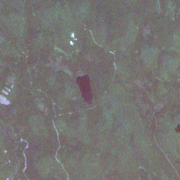

In [361]:
im1.image(['B1', 'B2', 'B3'], frame=lakeFrame)

### Creating list of custom objects

In [5]:
pathList=os.listdir('data/image_data')
pathList.sort()
pathListCSVs = [f for f in pathList if f.split('.')[1]=='csv']
pathListCSVs

['image01_2014_03_17.csv',
 'image02_2014_08_24.csv',
 'image03_2014_11_28.csv',
 'image04_2014_12_30.csv',
 'image05_2015_02_15.csv',
 'image06_2015_06_24.csv',
 'image07_2015_09_12.csv',
 'image08_2015_11_15.csv',
 'image09_2016_03_06.csv',
 'image10_2016_06_26.csv',
 'image11_2016_09_06.csv',
 'image12_2016_12_19.csv']

In [6]:
satImagesList = []
for im in pathListCSVs:
    df=pd.read_csv('data/image_data/'+im)
    df['black']=[0 for i in range(len(df))]
    bands = defaultdict(list)
    for band in list(df.columns[2:8]):
        bands[band]=df[band].values 
    tempImage = satelliteImage(bands=bands,
                               size=(651, 651),
                               date=datetime.date(int(im.split('_')[1]), 
                                                  int(im.split('_')[2]), 
                                                  int(im.split('_')[3].split('.')[0])),
                               name=im.split('_')[0])
    satImagesList.append(tempImage)
    
for im in satImagesList:
    print('-'*25)
    print(im.info())

-------------------------
Name: image01
Date: 2014-03-17
Size: (651, 651)
Avilable bands: ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']
None
-------------------------
Name: image02
Date: 2014-08-24
Size: (651, 651)
Avilable bands: ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']
None
-------------------------
Name: image03
Date: 2014-11-28
Size: (651, 651)
Avilable bands: ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']
None
-------------------------
Name: image04
Date: 2014-12-30
Size: (651, 651)
Avilable bands: ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']
None
-------------------------
Name: image05
Date: 2015-02-15
Size: (651, 651)
Avilable bands: ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']
None
-------------------------
Name: image06
Date: 2015-06-24
Size: (651, 651)
Avilable bands: ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']
None
-------------------------
Name: image07
Date: 2015-09-12
Size: (651, 651)
Avilable bands: ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']
None
-------------------------
Name: image08
Date: 2015-11-15
Size: (651, 651)
Av

### RGB images (True colors)

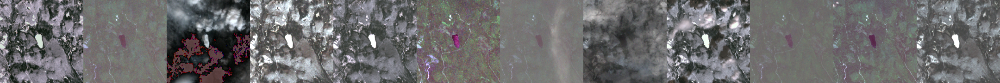

In [367]:
imlist=[]
for im in satImagesList:
    imlist.append(im.image(['B1', 'B2', 'B3'], frame=lakeFrame))
get_concat_h(imlist)

### B4

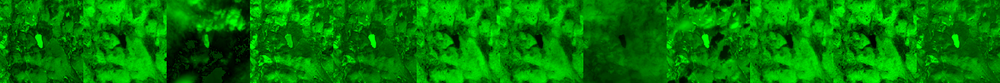

In [370]:
imlist=[]
for im in satImagesList:
    imlist.append(im.image([0,'B4',0], frame=lakeFrame))
get_concat_h(imlist)

### B5

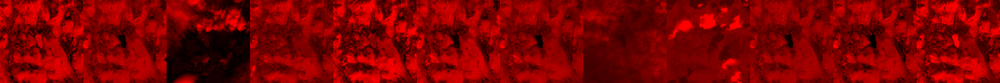

In [372]:
imlist=[]
for im in satImagesList:
    imlist.append(im.image(['B5',0, 0], frame=lakeFrame))
get_concat_h(imlist)

### B6

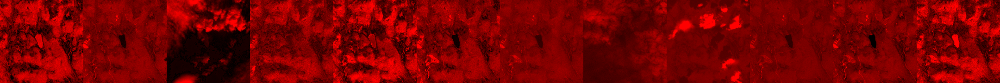

In [373]:
imlist=[]
for im in satImagesList:
    imlist.append(im.image(['B6',0, 0], frame=lakeFrame))
get_concat_h(imlist)

## Plotting band histograms

In [348]:
subplotTitles=np.array([[nm+' '+str(i.date) for nm in list(satImagesList[0].bands.keys())] for i in satImagesList]).reshape(-1)

In [325]:
fig = make_subplots(rows=len(satImagesList), cols=6, 
                    shared_xaxes=True, shared_yaxes=True, 
                    subplot_titles=subplotTitles)
for i,im in enumerate(satImagesList):
    for j, band in enumerate(im.bands.keys()):  
        fig.add_trace(im.bandStatsGraph(band, frame=lakeFrame),i+1,j+1)
fig.update_layout(autosize=False,
    width=1000,
    height=700, showlegend=False, 
    font=dict(size=5))
fig.update_annotations(font_size=6)
fig.show()

### Creating a dataframe for the lake frame for further calculations and visualisations

In [343]:
satImagesList[0].bandStats(band, frame=lakeFrame)

{'num': 32400,
 'min': 3,
 'mean': 137.97,
 'median': 143.0,
 'mode': 188,
 'max': 255,
 'variance': 2969.28}

In [344]:
dfDict = defaultdict(list)
for im in tqdm(satImagesList):
    print('Processing:', im.name)
    dfDict['name'].append(im.name)
    dfDict['date'].append(im.date)
    for band in satImagesList[0].bands.keys():
        res = im.bandStats(band, frame=lakeFrame)
        dfDict['min_'+band].append(res['min'])
        dfDict['mean_'+band].append(res['mean'])
        dfDict['median_'+band].append(res['median'])
        dfDict['mode_'+band].append(res['mode'])
        dfDict['max_'+band].append(res['max'])
        dfDict['variance_'+band].append(res['variance'])
df = pd.DataFrame(dfDict)

Processing: image01
Processing: image02
Processing: image03
Processing: image04
Processing: image05
Processing: image06
Processing: image07
Processing: image08
Processing: image09
Processing: image10
Processing: image11
Processing: image12



In [345]:
df.head()

,name,date,min_B1,mean_B1,median_B1,mode_B1,max_B1,variance_B1,min_B2,mean_B2,...,median_B5,mode_B5,max_B5,variance_B5,min_B6,mean_B6,median_B6,mode_B6,max_B6,variance_B6
0,image01,2014-03-17,2,106.14,108.0,212,212,2391.47,11,105.79,...,149.0,203,255,3002.93,3,137.97,143.0,188,255,2969.28
1,image02,2014-08-24,94,117.70,117.0,117,255,53.71,61,116.35,...,140.0,167,255,1608.39,7,124.31,123.0,142,255,619.56
2,image03,2014-11-28,1,65.58,62.0,98,243,2359.75,1,60.72,...,38.0,27,255,3666.93,3,70.43,39.0,25,255,4527.16
3,image04,2014-12-30,50,132.54,124.0,80,255,2341.22,57,133.30,...,125.0,118,255,1357.56,30,128.84,125.0,116,255,1431.20
4,image05,2015-02-15,42,103.75,98.0,95,254,1319.26,48,105.30,...,149.0,101,255,3556.67,5,142.65,144.0,93,255,3355.03


In [347]:
fig = make_subplots(rows=6, cols=1, 
                    shared_xaxes=True, 
                    subplot_titles=['Minimum Values', 
                                    'Mean Values', 
                                    'Mode Values', 
                                    'Median Values',
                                    'Maximum Values',
                                   'Variance Values'])

lineColors =['red',
             'green',
             'blue',
             'black',
             'grey',
             'pink']

for i, nm in enumerate(['min', 'mean', 'mode', 'median' ,'max', 'variance']):
    for cn, c in enumerate([c for c in df.columns[2:] if nm in c]):
        if i==0:
            legend=True
        else:
            legend=False
        fig.append_trace(go.Scatter(x=df['date'], y=df[c], name=c.split('_')[1],
                         line=dict(color=lineColors[cn], width=2),
                                opacity=0.75, showlegend=legend, hovertext=df['name']), row=i+1, col=1)

fig.update_layout(height=800)
fig.show()

In [192]:
satImagesList[11].show(bands=['B1','B2','B3'], frame=lakeFrame)

In [346]:
fig = make_subplots(rows=6, cols=1, 
                    shared_xaxes=True, 
                    subplot_titles=['Minimum Values', 
                                    'Mean Values', 
                                    'Mode Values', 
                                    'Median Values',
                                    'Maximum Values',
                                   'Variance Values'])

lineColors =['red',
             'green',
             'blue',
             'black',
             'grey',
             'pink']

for i, nm in enumerate(['min', 'mean', 'mode', 'median' ,'max', 'variance']):
    for cn, c in enumerate([c for c in df.columns[2:] if nm in c]):
        if i==0:
            legend=True
        else:
            legend=False
        if '1' not in c and '2' not in c and '3' not in c:
            fig.append_trace(go.Scatter(x=df['date'], y=df[c], name=c.split('_')[1],
                             line=dict(color=lineColors[cn], width=2),
                                    opacity=0.75, showlegend=legend, hovertext=df['name']), row=i+1, col=1)

fig.update_layout(height=800)
fig.show()

In [356]:
bands=['B1','B2','B3']
satImagesList[8].show(bands, frame=lakeFrame)

### Defining feet per pixel ratio

In [223]:
lakeTightFrame =(142,474,172,504)

In [221]:
satImagesList[2].info()
satImagesList[2].show(bands=['B1', 'B2', 'B3'], frame=lakeTightFrame)

Name: image03
Date: 2014-11-28
Size: (651, 651)
Avilable bands: ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']


In [225]:
feetPerPixel = 3000/(lakeTightFrame[3]-lakeTightFrame[1])
print(feetPerPixel)

100.0


### Extracting lake contour (beta, not succeded yet)

In [129]:
satImagesList[4].show(bands=[0,0,'B5'], frame=lakeFrame)

In [32]:
import cv2

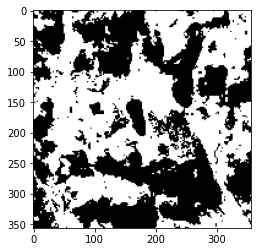

In [127]:
image = cv2.imread("img2.png")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
_, binary = cv2.threshold(gray, 140, 255, cv2.THRESH_BINARY_INV)
# show it
plt.imshow(binary, cmap="gray")
plt.show()

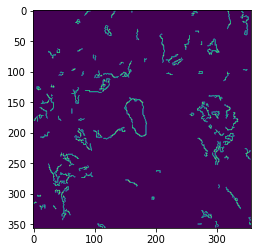

In [108]:
plt.imshow(cv2.Canny(gray,200,400))

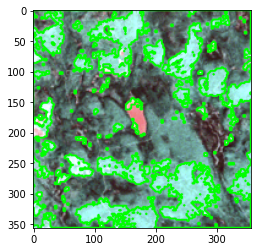

In [113]:
contours, hierarchy = cv2.findContours(binary, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
# draw all contours
image = cv2.drawContours(image, contours, -1, (0, 255, 0), 2)
plt.imshow(image)
plt.show()

In [70]:
hierarchy[0]

array([[  1,  -1,  -1,  -1],
       [  2,   0,  -1,  -1],
       [  3,   1,  -1,  -1],
       [ -1,   2,   4,  -1],
       [  5,  -1,  -1,   3],
       [  6,   4,  -1,   3],
       [  7,   5,  -1,   3],
       [  8,   6,  -1,   3],
       [  9,   7,  -1,   3],
       [ 10,   8,  -1,   3],
       [ 11,   9,  -1,   3],
       [ 12,  10,  -1,   3],
       [ 13,  11,  -1,   3],
       [ 14,  12,  -1,   3],
       [ 15,  13,  -1,   3],
       [ 16,  14,  -1,   3],
       [ 17,  15,  -1,   3],
       [ 18,  16,  -1,   3],
       [ 19,  17,  -1,   3],
       [ 20,  18,  -1,   3],
       [ 21,  19,  -1,   3],
       [ 22,  20,  -1,   3],
       [ 23,  21,  -1,   3],
       [ 24,  22,  -1,   3],
       [ 25,  23,  -1,   3],
       [ 26,  24,  -1,   3],
       [ 27,  25,  -1,   3],
       [ 28,  26,  -1,   3],
       [ 29,  27,  -1,   3],
       [ 30,  28,  -1,   3],
       [ 31,  29,  -1,   3],
       [ 32,  30,  -1,   3],
       [ 33,  31,  -1,   3],
       [ 34,  32,  -1,   3],
       [ 35,  

## EDA

This section was made initially before I decided to introduce SatelliteImage class

In [374]:
def showImage(df, channels=['B1','B2','B3'], imsize=(651,651)):
    """The function displays image with chosen channels"""
    plt.imshow(np.array(df[channels]).reshape(imsize[0],imsize[0],len(channels)))

In [375]:
pathList=os.listdir('data/image_data')
pathList.sort()
pathListCSVs = [f for f in pathList if f.split('.')[1]=='csv']
pathListCSVs

['image01_2014_03_17.csv',
 'image02_2014_08_24.csv',
 'image03_2014_11_28.csv',
 'image04_2014_12_30.csv',
 'image05_2015_02_15.csv',
 'image06_2015_06_24.csv',
 'image07_2015_09_12.csv',
 'image08_2015_11_15.csv',
 'image09_2016_03_06.csv',
 'image10_2016_06_26.csv',
 'image11_2016_09_06.csv',
 'image12_2016_12_19.csv']

In [376]:
pathListCSVs = [f for f in pathList if f.split('.')[1]=='csv']
pathListCSVs

['image01_2014_03_17.csv',
 'image02_2014_08_24.csv',
 'image03_2014_11_28.csv',
 'image04_2014_12_30.csv',
 'image05_2015_02_15.csv',
 'image06_2015_06_24.csv',
 'image07_2015_09_12.csv',
 'image08_2015_11_15.csv',
 'image09_2016_03_06.csv',
 'image10_2016_06_26.csv',
 'image11_2016_09_06.csv',
 'image12_2016_12_19.csv']

In [377]:
dfList = [pd.read_csv('data/image_data/'+f) for f in pathList if f.split('.')[1]=='csv']
dfListBlack = []
for df, f in zip(dfList, pathListCSVs):
    df['black']=[0 for i in range(len(df))]
    df['date']=['.'.join(f.split('.')[0].split('_')[1:]) for i in range(len(df))]
    dfListBlack.append(df)

In [378]:
dfListBlack[0].head()

,X,Y,B1,B2,B3,B4,B5,B6,black,date
0,0,0,169,159,175,147,222,225,0,2014.03.17
1,1,0,162,155,168,141,222,232,0,2014.03.17
2,2,0,151,143,156,132,210,210,0,2014.03.17
3,3,0,163,155,170,143,222,210,0,2014.03.17
4,4,0,148,137,145,125,191,203,0,2014.03.17


In [379]:
dfAll = pd.DataFrame()
for df in dfListBlack:
    dfAll = pd.concat([dfAll, df])

In [380]:
dfAll['date']=pd.to_datetime(dfAll['date'])
dfAll.head()

,X,Y,B1,B2,B3,B4,B5,B6,black,date
0,0,0,169,159,175,147,222,225,0,2014-03-17
1,1,0,162,155,168,141,222,232,0,2014-03-17
2,2,0,151,143,156,132,210,210,0,2014-03-17
3,3,0,163,155,170,143,222,210,0,2014-03-17
4,4,0,148,137,145,125,191,203,0,2014-03-17


In [381]:
dfDates=pd.DataFrame({'date':dfAll['date'].unique()})
dfDates['year']=dfDates['date'].apply(lambda x: x.year)
dfDates['month']=dfDates['date'].apply(lambda x: x.month)
dfDates['count']=[1 for i in range(len(dfDates))]
dfDates['quarter']=dfDates['date'].apply(lambda x: x.quarter)
dfDates

,date,year,month,count,quarter
0,2014-03-17,2014,3,1,1
1,2014-08-24,2014,8,1,3
2,2014-11-28,2014,11,1,4
3,2014-12-30,2014,12,1,4
4,2015-02-15,2015,2,1,1
5,2015-06-24,2015,6,1,2
6,2015-09-12,2015,9,1,3
7,2015-11-15,2015,11,1,4
8,2016-03-06,2016,3,1,1
9,2016-06-26,2016,6,1,2


In [382]:
dfDates['quarter'] = dfDates['quarter'].astype(str)
dfDates['year'] = dfDates['year'].astype(str)
fig=px.scatter(dfDates, x='month', y='year', color='quarter',category_orders={'year':['2016','2015','2014']})
fig.update_xaxes(dtick=1, range=[0.5,12.5]) 
fig.update_yaxes(dtick=1) 
fig.update_traces(marker_size=10)
fig.update_layout(yaxis=dict(type='category',categoryorder='category descending'))
fig.show()

### Trying another type of plot

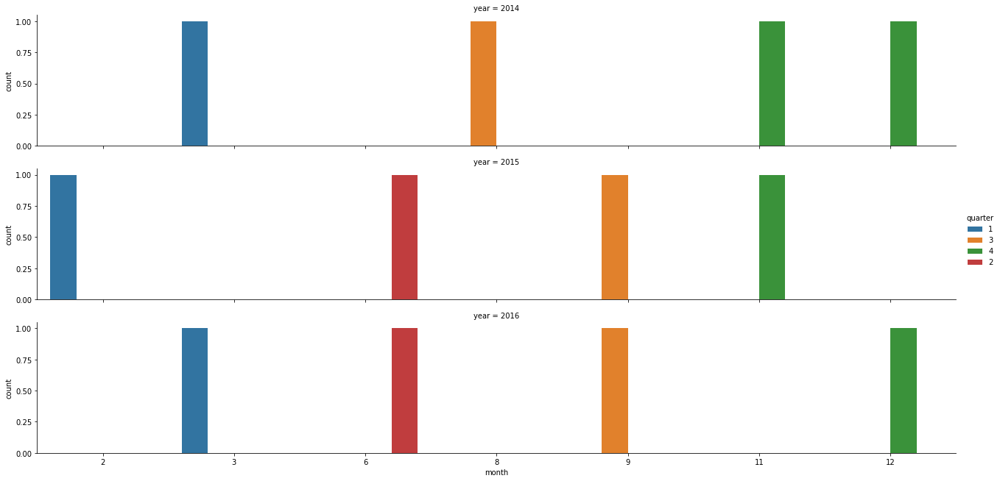

In [383]:
b = sns.catplot(x="month", y="count", 
                data=dfDates, kind='bar', 
                row='year', aspect=6, height=3, 
                hue='quarter')
params = {'font.size': 15}
plt.rcParams.update(params)

In [ ]:
Image.fromarray(np.uint8(imList[0])).show()

In [ ]:
getTiledImage(RgbImList)

In [ ]:
getTiledImage(imList).save('rgb.jpeg', 'JPEG')

In [ ]:
images = [Image.fromarray(np.uint8(im)) for im in imList]
imageio.mimsave('rgb.gif', images)

### B4, B3, B2

#### Changes in plant health

In [ ]:
imList = [np.array(df[['B4','B3','B2']]).reshape(651,651,3) for df in dfListBlack]
images = [Image.fromarray(np.uint8(im)) for im in imList]
imageio.mimsave('b4_b3_b2.gif', images)
getTiledImage(imList)

### B5, B4, B2
#### Floods or newly burned land

In [ ]:
imList = [np.array(df[['B5','B4','B2']]).reshape(651,651,3) for df in dfListBlack]
images = [Image.fromarray(np.uint8(im)) for im in imList]
imageio.mimsave('b5_b4_b2.gif', images)
getTiledImage(imList)

### B1, B5, B6
#### Enhanced differentiation between snow, ice and clouds

In [ ]:
imList = [np.array(df[['B1','B5','B6']]).reshape(651,651,3) for df in dfListBlack]
images = [Image.fromarray(np.uint8(im)) for im in imList]
imageio.mimsave('b1_b5_b6.gif', images)
getTiledImage(imList)

## Normalized Difference Vegetation Index (NDVI)
#### NDVI = (B4 - B3) / (B4 + B3)

In [385]:
from sklearn.preprocessing import MinMaxScaler

In [386]:
mms = MinMaxScaler()
dfListBlackConcatenated=pd.concat(dfListBlack)
dfListBlackConcatenated['NDVI']=(dfListBlackConcatenated['B4']-dfListBlackConcatenated['B3'])/(dfListBlackConcatenated['B4']+dfListBlackConcatenated['B3'])
mms.fit(dfListBlackConcatenated[['NDVI']].values)

MinMaxScaler(copy=True, feature_range=(0, 1))

In [387]:
dfListBlackConcatenated.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5085612 entries, 0 to 423800
Data columns (total 11 columns):
 #   Column  Dtype  
---  ------  -----  
 0   X       int64  
 1   Y       int64  
 2   B1      int64  
 3   B2      int64  
 4   B3      int64  
 5   B4      int64  
 6   B5      int64  
 7   B6      int64  
 8   black   int64  
 9   date    object 
 10  NDVI    float64
dtypes: float64(1), int64(9), object(1)
memory usage: 465.6+ MB


In [388]:
for df in dfListBlack:
    df['NDVI']=(df['B4']-df['B3'])/(df['B4']+df['B3'])
    df['NDVI_scaled']=mms.transform(df[['NDVI']].values)
    df['NDVI_scaled']=df['NDVI_scaled']*255

In [395]:
lakeFrame

(70, 400, 250, 580)

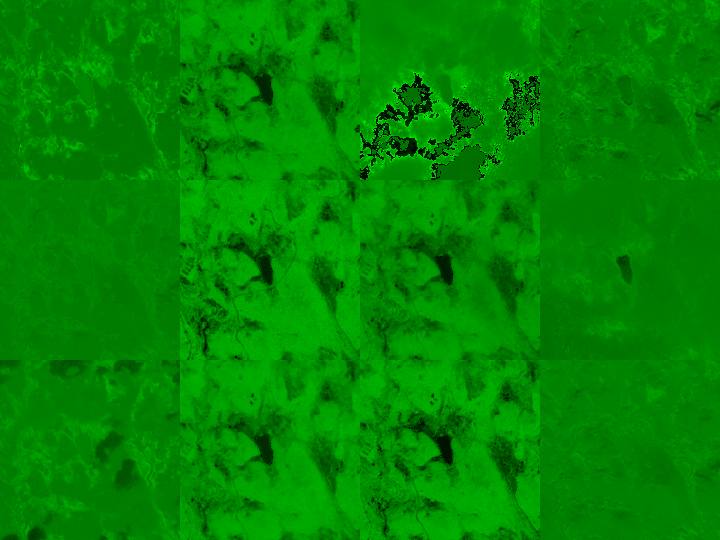

In [399]:
imList = [np.array(df[['black','NDVI_scaled','black']]).reshape(651,651,3)[400:580,70:250] for df in dfListBlack]
images = [Image.fromarray(np.uint8(im)) for im in imList]
imageio.mimsave('NDVI_scaled.gif', images)
getTiledImage(imList)